In [38]:
import pandas as pd 
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pycountry
import plotly.graph_objects as go
import plotly.express as px
from pandas.plotting import parallel_coordinates

In [39]:
all_data = pd.read_csv('./data/fifa/all_players.csv')
all_data.drop(['Unnamed: 0', 'Height', 'Weight', 'Alternative positions', 'play style', 'url'], axis = 1, inplace= True)

all_data

/var/folders/yk/fs7s5htj44b8ds6qh_c6gb0m0000gn/T/ipykernel_32198/2329133090.py:1: DtypeWarning:

Columns (33) have mixed types. Specify dtype option on import or set low_memory=False.



,Rank,Name,OVR,PAC,SHO,PAS,DRI,DEF,PHY,Acceleration,...,Preferred foot,Age,Nation,League,Team,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes
0,1,Kylian Mbappé,91,97,90,80,92,36,78,97,...,Right,25,France,LALIGA EA SPORTS,Real Madrid,NaN,NaN,NaN,NaN,NaN
1,2,Rodri,91,66,80,86,84,87,85,65,...,Right,28,Spain,Premier League,Manchester City,NaN,NaN,NaN,NaN,NaN
2,4,Erling Haaland,91,88,92,70,81,45,88,80,...,Left,24,Norway,Premier League,Manchester City,NaN,NaN,NaN,NaN,NaN
3,5,Jude Bellingham,90,80,87,83,88,78,83,81,...,Right,21,England,LALIGA EA SPORTS,Real Madrid,NaN,NaN,NaN,NaN,NaN
4,7,Vini Jr.,90,95,84,81,91,29,69,95,...,Right,24,Brazil,LALIGA EA SPORTS,Real Madrid,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17732,17146,Araya Dennis,53,42,57,49,52,25,42,44,...,Right,18,England,Barclays WSL,Spurs,NaN,NaN,NaN,NaN,NaN
17733,17146,Alexia Férnandez,53,53,55,51,53,34,47,52,...,Right,22,Spain,Liga F,Granada CF,NaN,NaN,NaN,NaN,NaN
17734,17146,Aleigh Gambone,53,60,58,53,56,49,53,58,...,Right,23,United States,Scottish Women's League,Glasgow City FC,NaN,NaN,NaN,NaN,NaN
17735,17146,Joy Lysser,53,61,52,48,56,53,58,60,...,Left,20,Switzerland,Schweizer Damen Liga,FC Zürich,NaN,NaN,NaN,NaN,NaN


In [40]:
#lm
lm_data = all_data[all_data['Position'] == 'LM']
lm_data.sort_values('OVR', ascending=False)[:30]
lm_data.reset_index(inplace=True)
lm_data.drop(columns='index', axis=1, inplace=True)
lm_data.head()

/var/folders/yk/fs7s5htj44b8ds6qh_c6gb0m0000gn/T/ipykernel_32198/2685634311.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,Rank,Name,OVR,PAC,SHO,PAS,DRI,DEF,PHY,Acceleration,...,Preferred foot,Age,Nation,League,Team,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes
0,76,Grimaldo,86,74,73,88,85,76,71,77,...,Left,28,Spain,Bundesliga,Leverkusen,NaN,NaN,NaN,NaN,NaN
1,101,Nico Williams,85,93,75,78,86,36,65,94,...,Right,22,Spain,LALIGA EA SPORTS,Athletic Club,NaN,NaN,NaN,NaN,NaN
2,149,Kingsley Coman,84,89,75,79,87,30,62,92,...,Right,28,France,Bundesliga,FC Bayern München,NaN,NaN,NaN,NaN,NaN
3,149,Sadio Mané,84,83,81,78,86,44,75,82,...,Right,32,Senegal,ROSHN Saudi League,Al Nassr,NaN,NaN,NaN,NaN,NaN
4,222,Dušan Tadić,83,64,79,85,81,43,78,65,...,Left,35,Serbia,Trendyol Süper Lig,Fenerbahçe,NaN,NaN,NaN,NaN,NaN


In [41]:
#RW
lw_data = all_data[all_data['Position'] == 'LW']
lw_data.sort_values('OVR', ascending=False)[:30]
lw_data.reset_index(inplace=True)
lw_data.drop(columns='index', inplace=True)
lw_data.head()

/var/folders/yk/fs7s5htj44b8ds6qh_c6gb0m0000gn/T/ipykernel_32198/557354725.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,Rank,Name,OVR,PAC,SHO,PAS,DRI,DEF,PHY,Acceleration,...,Preferred foot,Age,Nation,League,Team,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes
0,7,Vini Jr.,90,95,84,81,91,29,69,95,...,Right,24,Brazil,LALIGA EA SPORTS,Real Madrid,NaN,NaN,NaN,NaN,NaN
1,52,Neymar Jr,87,85,79,84,92,37,60,86,...,Right,32,Brazil,ROSHN Saudi League,Al Hilal,NaN,NaN,NaN,NaN,NaN
2,74,Rafael Leão,86,94,79,80,87,28,77,94,...,Right,25,Portugal,Serie A Enilive,Milano FC,NaN,NaN,NaN,NaN,NaN
3,101,Khvicha Kvaratskhelia,85,86,79,80,86,41,71,85,...,Right,23,Georgia,Serie A Enilive,SSC Napoli,NaN,NaN,NaN,NaN,NaN
4,149,Luis Díaz,84,90,80,75,87,39,75,91,...,Right,27,Colombia,Premier League,Liverpool,NaN,NaN,NaN,NaN,NaN


In [42]:
lm_stats = ['OVR', 'PAC', 'Dribbling', 'Short Passing', 'Stamina', 'Ball Control', 'Long Passing']
lw_stats = ['OVR', 'PAC', 'Finishing', 'Crossing', 'Shot Power', 'Positioning', 'Composure']

In [43]:
fig = go.Figure()

for player in lm_data.Name:
    player_data = lm_data[lm_data['Name'] == player][lm_stats].values.flatten()
    fig.add_trace(
        go.Bar(
            x=lm_stats,
            y=player_data,
            name=player,
            visible=False
        )
    )

fig.data[0].visible = True


fig.update_layout(
    updatemenus=[
        dict(
            buttons=[
                dict(
                    args=[{"visible": [i == j for i in range(len(lm_data['Name']))]}],  
                    label=player,
                    method='update'
                )
                for j, player in enumerate(lm_data['Name'])  
            ],
            direction='down',
            showactive=True,
        )
    ]
)

fig.update_layout(
    title='Best 30 LM',
    xaxis_title='Attributes',
    yaxis_title='Value',
    showlegend=False
)

fig.show()

In [44]:
for stat in lm_stats:
    print(f'Name {lm_data.Name[lm_data[stat].idxmax()]}, index: {lm_data[stat].idxmax()}, best atribute is: {stat} and its value is: {lm_data[stat].iloc[lm_data[stat].idxmax()]}')

Name Guro Reiten, index: 968, best atribute is: OVR and its value is: 88
Name Karim Adeyemi, index: 21, best atribute is: PAC and its value is: 96
Name Jadon Sancho, index: 7, best atribute is: Dribbling and its value is: 91
Name Grimaldo, index: 0, best atribute is: Short Passing and its value is: 87
Name Marco Grüll, index: 82, best atribute is: Stamina and its value is: 93
Name Kingsley Coman, index: 2, best atribute is: Ball Control and its value is: 87
Name Grimaldo, index: 0, best atribute is: Long Passing and its value is: 85


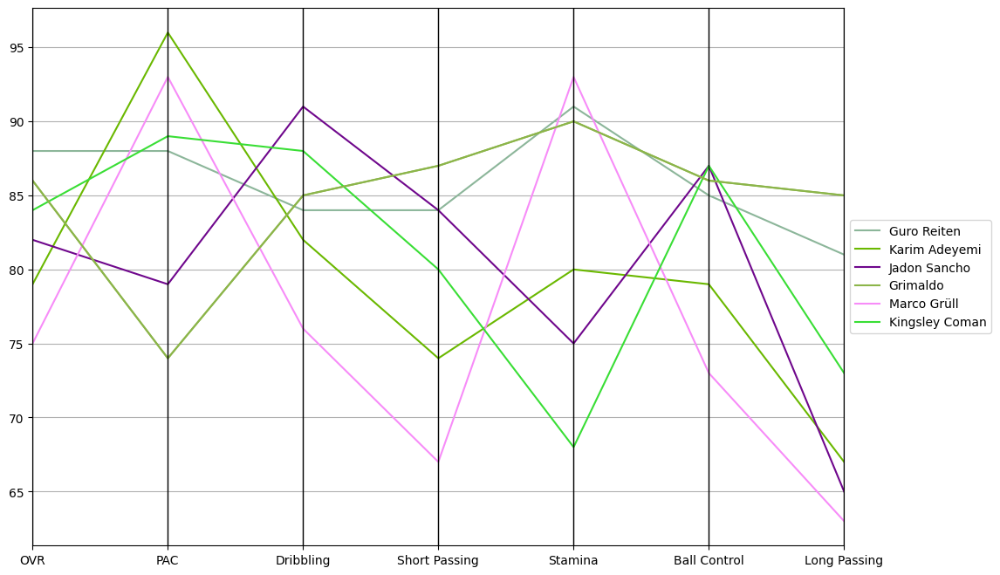

In [45]:
best_lm = lm_data.loc[lm_data[lm_stats].idxmax()]

plt.figure(figsize=(12,8))
parallel_coordinates(best_lm, class_column='Name', cols=lm_stats)
plt.legend(loc='center left', bbox_to_anchor=(1,0.5))
plt.show()

1) Karim Adeyemi
2) Grimaldo/Jadon Sancho

In [46]:
lw_data = all_data[all_data['Position'] == 'LW']
lw_data = lw_data.sort_values('OVR', ascending=False)[:30]
lw_data.reset_index(inplace=True)
lw_data.drop(columns='index', inplace=True)
lw_data.head()

,Rank,Name,OVR,PAC,SHO,PAS,DRI,DEF,PHY,Acceleration,...,Preferred foot,Age,Nation,League,Team,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes
0,7,Vini Jr.,90,95,84,81,91,29,69,95,...,Right,24,Brazil,LALIGA EA SPORTS,Real Madrid,NaN,NaN,NaN,NaN,NaN
1,52,Neymar Jr,87,85,79,84,92,37,60,86,...,Right,32,Brazil,ROSHN Saudi League,Al Hilal,NaN,NaN,NaN,NaN,NaN
2,80,Lauren Hemp,86,90,76,84,87,63,70,91,...,Left,24,England,Barclays WSL,Manchester City,NaN,NaN,NaN,NaN,NaN
3,74,Rafael Leão,86,94,79,80,87,28,77,94,...,Right,25,Portugal,Serie A Enilive,Milano FC,NaN,NaN,NaN,NaN,NaN
4,101,Caitlin Foord,85,87,78,80,83,45,70,89,...,Right,29,Australia,Barclays WSL,Arsenal,NaN,NaN,NaN,NaN,NaN


In [47]:
#RW
fig = go.Figure()

for player in lw_data.Name:
    player_data = lw_data[lw_data['Name'] == player][lw_stats].values.flatten()
    fig.add_trace(
        go.Bar(
            x=lw_stats,
            y=player_data,
            name=player,
            visible=False
        )
    )

fig.data[0].visible = True


fig.update_layout(
    updatemenus=[
        dict(
            buttons=[
                dict(
                    args=[{"visible": [i == j for i in range(len(lw_data['Name']))]}],  
                    label=player,
                    method='update'
                )
                for j, player in enumerate(lw_data['Name'])  
            ],
            direction='down',
            showactive=True,
        )
    ]
)

fig.update_layout(
    title='Best 30 LW',
    xaxis_title='Attributes',
    yaxis_title='Value',
    showlegend=False
)

fig.show()

In [48]:
for stat in lw_stats:
    print(f'Name: {lw_data.Name[lw_data[stat].idxmax()]}, ability {stat}, value: {lw_data[stat].iloc[lw_data[stat].idxmax()]}')

Name: Vini Jr., ability OVR, value: 90
Name: Vini Jr., ability PAC, value: 95
Name: Vini Jr., ability Finishing, value: 89
Name: Lauren Hemp, ability Crossing, value: 92
Name: Luis Díaz, ability Shot Power, value: 84
Name: Vini Jr., ability Positioning, value: 87
Name: Neymar Jr, ability Composure, value: 92


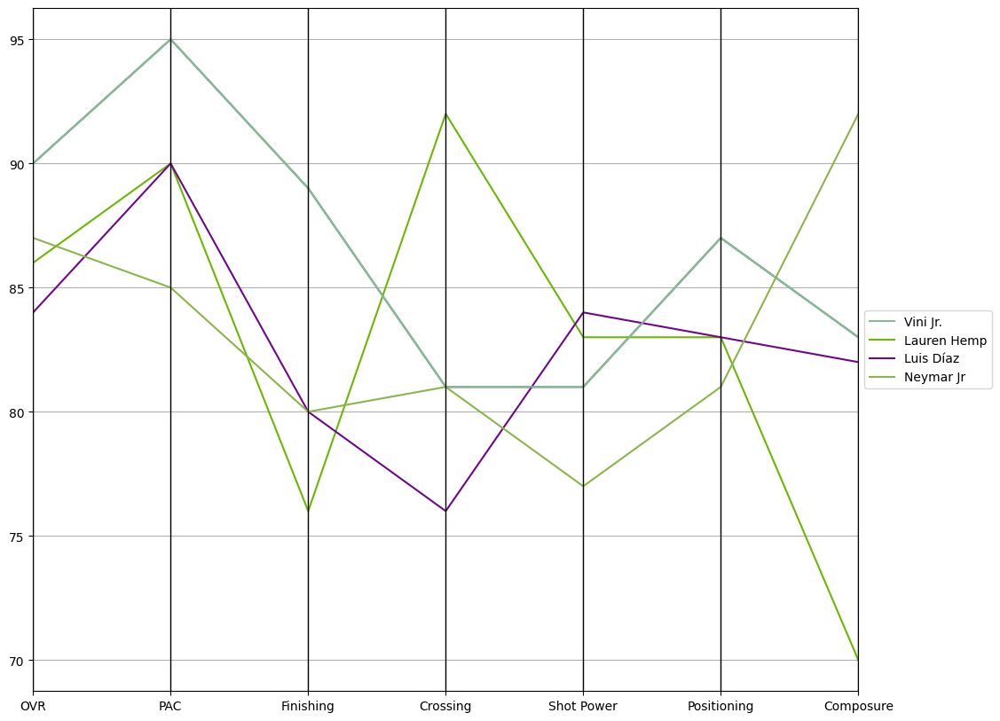

In [49]:
lw_best = lw_data.loc[lw_data[lw_stats].idxmax()]

plt.figure(figsize=(12,10))
parallel_coordinates(lw_best, class_column='Name', cols=lw_stats)
plt.legend(loc = 'center left', bbox_to_anchor=(1,0.5))
plt.show()


1) Vini Jr.
2) Lauren Hemp/Neymar Jr.